# **Sample Quality Check - Durham Police Department Arrest Reports**
### Introduction
This document contains sample code and instructions on how to evaluate the conditions of data once it is in a table format based on factors such as accuracy, completeness, consistency, reliability and whether it's up to date.
- **Quality metrics**: 
    - Completenes % (Counts & proportions of NAs)
        - Which NAs are relevant? Which should we try to impute or delete entirely?
    - Consistency and Validity (Value Counts, search for typos)
        - How to fix inconsistent categorical values?
    - Reliability (Perceived vs. Self reported, which values should be consistent?)
    - Currency (Dates, how old is too old?)
- **Summary statistics**:
    - Mean, min, max for continuous variables, crosstabs for discrete
    - Cross-comparison counts for discrete categorical variables 
- **Distributions**:
    - Histograms for continuous variables
    - Crosstabs, barplots for discrete categoricals variables

### **Step #1:** Load the data

In [1]:
# Load that datasets avaialble in table format:
# https://www.practicaldatascience.org/html/pandas_series.html offers a quick tutorial on how to use the Pandas library if you are not familiar.
# The most common table data format is csv (comma separated values).
# Other common functions you may use to load the data are: pd.read_excel, pd.read_stata.

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style("whitegrid")
sns.set(rc={'figure.figsize':(11.7,8.27)})

pd.set_option("display.max_columns", 500)
pd.set_option("display.max_rows", 5)

arrests = pd.read_csv(
    "/Users/clarissaache/Documents/Data+/Small-Town-Policing-Accountability-Data-2022/10 Clean Data/arrests_charges.csv",
    index_col=[0],
)


# Take a first look:
pd.set_option("display.max_rows", None)
arrests.sample(5)


,agencyname,datetimeofarrest,file,arrestnumber,scars_tattoes_bodymarkings_etc,age,race,sex,citizenship,skintone,height,weight,haircolor,eyecolor,armed,typeofarrest,placeofarrest,page_num,charges,charge_type,charge_counts,charge_IBRcode,charge_statutenumber,charge_warrantdate,chargenum
24027,Durham Police Department,05/08/2020 21:12,00 Raw Data/data/arrests0012273.pdf,318150,NaN,49,I,F,US,Light,5'08,130.0,Black,Brown,UNARMED,ON VIEW,"9 CLUBSTONE CT, DURHAM",0.0,Breaking And Entering Building (misdemeanor),Misd,1.0,220,14-54(B),05/08/2020,1
21402,Durham Police Department,03/18/2021 20:44,00 Raw Data/data/arrests0004397.pdf,322526,NaN,25,B,M,US,NaN,6'05,NaN,Black,Black,UNARMED,TAKEN INTO CUSTODY,"219 S MANGUM ST, DURHAM",0.0,Wrongfully Obtain/divulging Telephonic Messages,Misd,1.0,90Z,14-370,03/15/2021,3
2367,Durham Police Department,07/09/2020 16:37,00 Raw Data/data/arrests0012473.pdf,319096,TATT LEFT ARM / LO; TATT LEFT ARM / CROSS; TA...,21,B,M,US,Medium,5'09,145.0,Black,Brown,UNARMED,ON VIEW,"2850 COURTNEY CREEK BLVD - 1236, DURHAM",0.0,Violation Of Release Order,Fel,1.0,90Z,15A-531,07/09/2020,1
16000,Durham Police Department,12/13/2019 16:39,00 Raw Data/data/arrests0010994.pdf,315743,SCAR LEFT KNEE,19,B,M,US,Black,5'11,150.0,Black,Brown,UNARMED,TAKEN INTO CUSTODY,"219 S MANGUM ST, DURHAM",0.0,Resist Delay Obstruct Public Officer,Misd,1.0,90Z,14-223,11/15/2019,1
25726,Durham Police Department,05/18/2022 04:50,00 Raw Data/data/arrests0006619.pdf,330599,NaN,31,B,M,US,Light,6'02,NaN,Black,Green,UNARMED,ON VIEW,"1800 WILLIAMSBURG RD, DURHAM",0.0,Possess Control Substance Schedule I,Fel,1.0,35A,90-95(A3)1,05/18/2022,1


### **Step #2:** Which type of data do we have?
Typically, police records inform of interactions between the police and a civilian. The first step in measuring the quality of your dataset is finding out which type of data you have. 
As you understand the types of fields you have, define the unit of observation. Think of what does one row in your table represent.<br>
In this example, one row is one police charge. However, there is also a hierarchy of rows. All charge to the same person on one police interaction are under the same id, called "case" which has a unique identifier called "arrest number". Keep in mind this hierarchy is important to understand how police interacts with individual people. 

In [2]:
# Check the names of the columns and verify agains the provided Metadata document which information is relevant to analysis you may wish to perform
arrests.columns


Index(['agencyname', 'datetimeofarrest', 'file', 'arrestnumber',
       'scars_tattoes_bodymarkings_etc', 'age', 'race', 'sex', 'citizenship',
       'skintone', 'height', 'weight', 'haircolor', 'eyecolor', 'armed',
       'typeofarrest', 'placeofarrest', 'page_num', 'charges', 'charge_type',
       'charge_counts', 'charge_IBRcode', 'charge_statutenumber',
       'charge_warrantdate', 'chargenum'],
      dtype='object')

In [3]:
# Look for unique identifiers to find the level of granularity of your data:
# If there are no unique columns are
print(arrests["arrestnumber"].is_unique)  # for example: arrest number is not unique for each offense, but it is unique for a case

# Look at the number of rows with the same "unique" identifier, are they all the same person? Same case w/ different people?
arrests.loc[arrests['arrestnumber']==308874]

False


,agencyname,datetimeofarrest,file,arrestnumber,scars_tattoes_bodymarkings_etc,age,race,sex,citizenship,skintone,height,weight,haircolor,eyecolor,armed,typeofarrest,placeofarrest,page_num,charges,charge_type,charge_counts,charge_IBRcode,charge_statutenumber,charge_warrantdate,chargenum
22715,Durham Police Department,01/20/2019 18:59,00 Raw Data/data/arrests0006773.pdf,308874,TATT LEFT NECK / SIDE OF NECK,41,B,M,US,Black,6'02,200.0,Black,Brown,UNARMED,TAKEN INTO CUSTODY,"219 S MANGUM ST, DURHAM",0.0,Probation Violation,Misd,1.0,90Z,15A-1345,08/16/2018,1


### **Step #3:** Measure data quality (completeness, currency, reliability & consistency)
The completeness of fields in your dataset will determine if you can conduct conclusive analysis. For example, one column *"scars_tattoes_bodymarkings_etc"* has missing values in most rows. In this example, there are 2 posibilities: (1) This information is often forgotten or impossible to collect by the police. (2) A missing value means there absence of visible "scars, tattoes or bodymarkings".<br>
In any case, this column is probably not an important feature to study racial and gender biases, so we can ignore or drop it from the dataset.

In [4]:
# Measure data completeness and data types:
def missing_zero_values_table(df):
    zero_val = (df == 0.00).astype(int).sum(axis=0)
    mis_val = df.isnull().sum()
    mis_val_percent = 100 * df.isnull().sum() / len(df)
    mz_table = pd.concat([zero_val, mis_val, mis_val_percent], axis=1)
    mz_table = mz_table.rename(
        columns={0: "Zero Values", 1: "Missing Values", 2: "% of Total Values"}
    )
    mz_table["Total Zero Missing Values"] = (
        mz_table["Zero Values"] + mz_table["Missing Values"]
    )
    mz_table["% Total Zero Missing Values"] = (
        100 * mz_table["Total Zero Missing Values"] / len(df)
    )
    mz_table["Data Type"] = df.dtypes
    mz_table = (
        mz_table[mz_table.iloc[:, 1] != 0]
        .sort_values("% of Total Values", ascending=False)
        .round(1)
    )
    print(
        "Your selected dataframe has "
        + str(df.shape[1])
        + " columns and "
        + str(df.shape[0])
        + " Rows.\n"
        "There are " + str(mz_table.shape[0]) + " columns that have missing values."
    )
    #         mz_table.to_excel('D:/sampledata/missing_and_zero_values.xlsx', freeze_panes=(1,0), index = False)
    return mz_table


missing_zero_values_table(arrests)


Your selected dataframe has 25 columns and 27526 Rows.
There are 7 columns that have missing values.


,Zero Values,Missing Values,% of Total Values,Total Zero Missing Values,% Total Zero Missing Values,Data Type
scars_tattoes_bodymarkings_etc,0,16049,58.3,16049,58.3,object
skintone,0,2285,8.3,2285,8.3,object
weight,0,2158,7.8,2158,7.8,float64
citizenship,0,914,3.3,914,3.3,object
eyecolor,0,827,3.0,827,3.0,object
haircolor,0,690,2.5,690,2.5,object
armed,0,26,0.1,26,0.1,object


In [5]:
# Fix data types:
# For example, change date columns to "datetime" type:
arrests["datetimeofarrest"] = pd.to_datetime(
    arrests["datetimeofarrest"], infer_datetime_format=True
)
# Create a year column
arrests["year"] = arrests["datetimeofarrest"].dt.strftime("%Y")
# Create a year/month column
arrests["mo_yr"] = arrests["datetimeofarrest"].dt.strftime("%m-%Y")
arrests.sample(5)


,agencyname,datetimeofarrest,file,arrestnumber,scars_tattoes_bodymarkings_etc,age,race,sex,citizenship,skintone,height,weight,haircolor,eyecolor,armed,typeofarrest,placeofarrest,page_num,charges,charge_type,charge_counts,charge_IBRcode,charge_statutenumber,charge_warrantdate,chargenum,year,mo_yr
23581,Durham Police Department,2019-11-06 04:07:00,00 Raw Data/data/arrests0011883.pdf,314962,NaN,52,B,M,US,Dark,5'07,147.0,Black,Brown,UNARMED,ON VIEW,"1399 N ALSTON AVE/DOWD ST, DURHAM",0.0,Possession Of Drug Paraphernalia,Misd,1.0,35B,90-113.22,11/06/2019,2,2019,11-2019
26651,Durham Police Department,2019-10-06 05:37:00,00 Raw Data/data/arrests0012601.pdf,314294,SCAR RIGH EYE; TATT RIGH ARM / MEZ,35,B,F,US,Medium,5'04,150.0,Other,Brown,UNARMED,TAKEN INTO CUSTODY,"4600 UNIVERSITY DR - 211, DURHAM",0.0,Injury To Personal Property,Misd,1.0,290,14-160,10/06/2019,2,2019,10-2019
9111,Durham Police Department,2021-12-27 19:47:00,00 Raw Data/data/arrests0000273.pdf,327551,NaN,44,B,F,US,Medium,5'02,185.0,Black,Brown,UNARMED,ON VIEW,"507 E KNOX ST, DURHAM",0.0,Trespass (second Degree),Misd,1.0,90J,14-159.13,12/27/2021,1,2021,12-2021
12927,Durham Police Department,2020-07-28 17:28:00,missing2/arrests0000153.pdf,319325,NaN,29,B,M,US,Medium,6'03,190.0,Black,Brown,UNARMED,ON VIEW,"2508 KINGDOM WAY, DURHAM",0.0,Communicating Threats,Misd,1.0,13C,14-277.1,07/28/2020,2,2020,07-2020
1161,Durham Police Department,2021-09-02 00:01:00,00 Raw Data/data/arrests0002109.pdf,326004,NaN,31,W,F,US,Fair,5'04,155.0,Blonde,Blue,UNARMED,SUMMONED/CITED,"1233 UNIVERSITY DR, DURHAM",0.0,Concealment Of Merchandise,Misd,1.0,23C,14-72.1(A),09/02/2021,1,2021,09-2021


<AxesSubplot:title={'center':'Count of Cases per year'}, xlabel='year'>

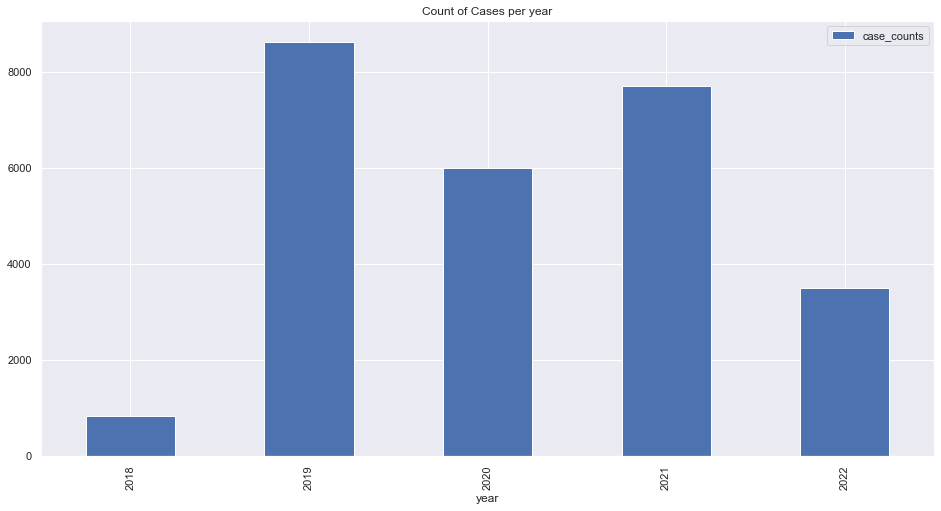

In [6]:
# Another way to check for missing values is looking at trends
# Lets look at # of cases per year:
arrests = arrests.drop_duplicates(keep='first')
arrests["case_counts"] = 1
cases = arrests[["case_counts", "year"]].groupby(by=["year"]).sum().reset_index()
cases.plot(kind="bar", figsize=(16, 8), title="Count of Cases per year", x="year")


<AxesSubplot:title={'center':'Count of Cases per Month'}, xlabel='mo_yr'>

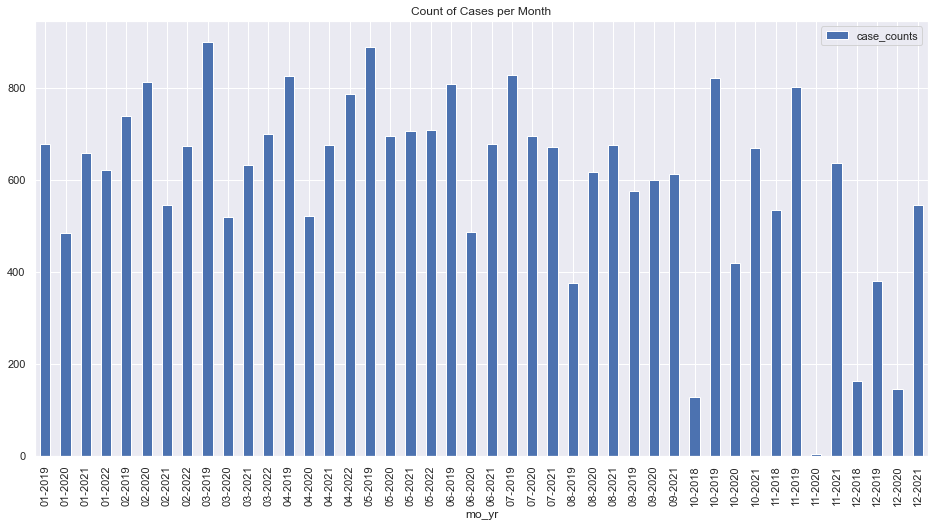

In [7]:
# It may be work looking at cases per month as well
arrests["case_counts"] = 1
cases = arrests[["case_counts", "mo_yr"]].groupby(by=["mo_yr"]).sum().reset_index()
cases.plot(kind="bar", figsize=(16, 8), title="Count of Cases per Month", x="mo_yr")

<AxesSubplot:title={'center':'Count of Cases per Month'}, xlabel='mo_yr'>

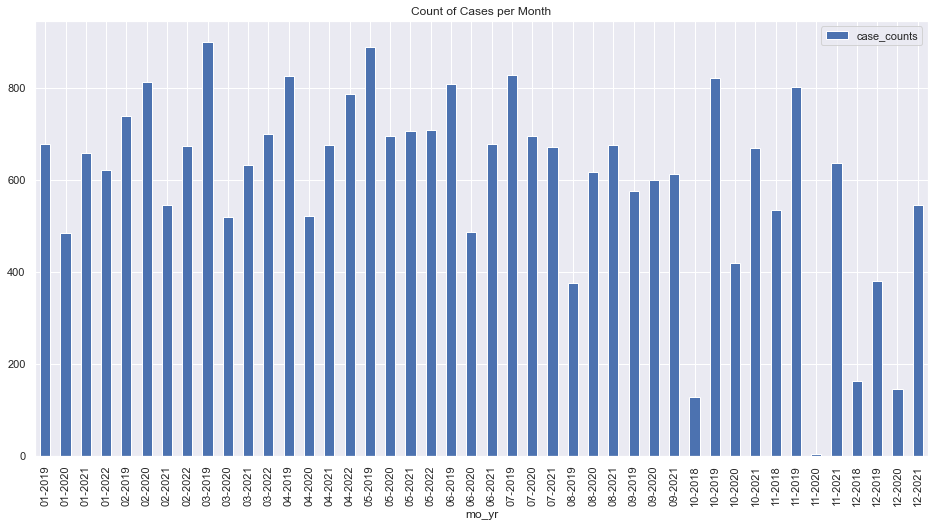

In [8]:
# Oh no! There may be duplicates. Here is how to drop them:
arrests = arrests.drop_duplicates(keep='first')
# Now, we plot again
arrests["case_counts"] = 1
cases = arrests[["case_counts", "mo_yr"]].groupby(by=["mo_yr"]).sum().reset_index()
cases.plot(kind="bar", figsize=(16, 8), title="Count of Cases per Month", x="mo_yr")
# MUCH BETTER!

**Note:** *Data collection for this data set started with cases from Octobe 2018, the most recent case is from the last day of May in 2022. With this information we can say there are no unexpected trends in the count of cases per year. However, when we break down the counts by month we can see outliers in 04-2022 and 10/2018 and 11-2020. In order to proceed, we need to make sure we understand these irregularities in the data. The low counts in November 2021 and October 2018 can be explained by problems faced scrapping the data from the police department website. The high counts in march 2022 can be duplicates!*
<br>
Categorical values can be checked for correctness based on how consistent are categories.

In [9]:
# To check for consistency of categorical values, use ".value_counts()" in each categorical column
# Think of the possible categories of that column and if there are possible typos, change the type
# For example:
print("\nSkin Tone:")
print(arrests['skintone'].value_counts())
print("\nRace:")
print(arrests['race'].value_counts())
print("\nType of Arrest:")
print(arrests['typeofarrest'].value_counts())
print("\nCharge Type:")
print(arrests['charge_type'].value_counts())


Skin Tone:
Medium     11000
Dark        5879
Light       3482
Fair        2213
Black       1015
Olive        749
Other         32
Unknown       16
Ruddy          9
Albino         2
Yellow         1
Name: skintone, dtype: int64

Race:
B    20614
W     5848
A       99
U       53
I       47
Name: race, dtype: int64

Type of Arrest:
TAKEN INTO CUSTODY    12463
ON VIEW               10864
SUMMONED/CITED         3334
Name: typeofarrest, dtype: int64

Charge Type:
Misd    18579
Fel      8080
I           1
2           1
Name: charge_type, dtype: int64


In [10]:
# Lets examine the non-conforming categories in the "charge_type" column:
arrests.loc[arrests['charge_type']=='I']

,agencyname,datetimeofarrest,file,arrestnumber,scars_tattoes_bodymarkings_etc,age,race,sex,citizenship,skintone,height,weight,haircolor,eyecolor,armed,typeofarrest,placeofarrest,page_num,charges,charge_type,charge_counts,charge_IBRcode,charge_statutenumber,charge_warrantdate,chargenum,year,mo_yr,case_counts
6444,Durham Police Department,2022-03-27 13:23:00,00 Raw Data/data/arrests0003131.pdf,329847,NaN,19,B,M,US,Dark,5'05,135.0,Black,Brown,UNARMED,TAKEN INTO CUSTODY,"3643 N ROXBORO ST, DURHAM",0.0,Speeding - Failure To Reduce To Avoid Accident,I,1.0,9914,20-141(M),03/27/2022,3,2022,03-2022,1


In [11]:
# TROUBLESHOOTING: One option is to look at which type of charge is often given to the charge in question
print(arrests.loc[arrests['charges']=='Speeding - Failure To Reduce To Avoid Accident', 'charge_type'].value_counts())

#Here we can see that this charge is always a misdemeanor, except for that one potential typo. To fix it, use:
arrests.loc[arrests['charge_type']=='I', 'charge_type']='Misd'
arrests.loc[arrests['charge_type']=='2', 'charge_type']='Misd' 

# Done! (do the same for the other potential typo)

Misd    17
I        1
Name: charge_type, dtype: int64


### **Step #4:** Compute Summary Statistics
Numerical fields can be summarized using quantiles, mean and median.<br>
Categorical fields can be summarized using tables.<br>

In [12]:
# Numerical Variables
arrests['age'].describe() 

# the mean age of the arrested population between October 2018 and June 2022 is 34 years. 
# Age max value is 92 and the minimum is 0. Lets investigate the 0 age rows

count    26661.000000
mean        33.808147
std         11.619389
min          0.000000
25%         25.000000
50%         31.000000
75%         41.000000
max         92.000000
Name: age, dtype: float64

In [13]:
print(len(arrests.loc[arrests['age']==0]))
arrests.loc[arrests['age']<18] # these could be typos. 

6


,agencyname,datetimeofarrest,file,arrestnumber,scars_tattoes_bodymarkings_etc,age,race,sex,citizenship,skintone,height,weight,haircolor,eyecolor,armed,typeofarrest,placeofarrest,page_num,charges,charge_type,charge_counts,charge_IBRcode,charge_statutenumber,charge_warrantdate,chargenum,year,mo_yr,case_counts
5657,Durham Police Department,2021-09-22 22:13:00,00 Raw Data/data/arrests0001774.pdf,326227,TATT ALL NECK / BABY BOY; TATT NECK; PI...,0,B,M,US,Medium,5'08,155.0,Black,Brown,UNARMED,TAKEN INTO CUSTODY,"4815 S SINGING WOODS PL, DURHAM",0.0,Assault On Female,Misd,1.0,13B,14-33(C2),09/20/2021,1,2021,09-2021,1
6243,Durham Police Department,2020-04-30 16:00:00,00 Raw Data/data/arrests0013640.pdf,318045,NaN,0,B,F,US,Unknown,5'06,140.0,Unknown/Bald,Unknown,UNARMED,ON VIEW,"3825 S ROXBORO ST, DURHAM",0.0,Larceny (misdemeanor),Misd,1.0,23H,14-72(A) M,04/30/2020,1,2020,04-2020,1
6244,Durham Police Department,2020-04-30 16:00:00,00 Raw Data/data/arrests0013640.pdf,318045,NaN,0,B,F,US,Unknown,5'06,140.0,Unknown/Bald,Unknown,UNARMED,ON VIEW,"3825 S ROXBORO ST, DURHAM",0.0,Resist Delay Obstruct Public Officer,Misd,1.0,90Z,14-223,04/30/2020,2,2020,04-2020,1
6245,Durham Police Department,2020-05-13 03:06:00,00 Raw Data/data/arrests0011418.pdf,318227,NaN,0,B,F,US,Unknown,5'06,140.0,Unknown/Bald,Unknown,UNARMED,ON VIEW,"1002 N ALSTON AVE, DURHAM",0.0,Possessing Stolen Goods,Fel,1.0,280,14-71.1,05/13/2020,1,2020,05-2020,1
20258,Durham Police Department,2022-02-17 15:08:00,00 Raw Data/data/arrests0004535.pdf,328253,NaN,0,W,M,HD,Medium,5'08,200.0,Black,Brown,UNARMED,ON VIEW,"1525 GLENN SCHOOL RD, DURHAM",0.0,Shoplifting,Misd,1.0,23C,14-72.1,02/17/2022,1,2022,02-2022,1
26980,Durham Police Department,2020-02-27 14:44:00,00 Raw Data/data/arrests0009112.pdf,317336,TATT RIGH CHEST / EMPTY FIVE POINT STAR; TATT ...,0,B,M,US,Medium,6'00,175.0,Black,Brown,UNARMED,TAKEN INTO CUSTODY,"322 JUNCTION RD, DURHAM",0.0,Warrant Service For Other Jurisdiction,Misd,1.0,9910,WARR,02/26/2020,1,2020,02-2020,1


Missing values can be imputed using the mean age or just dropped from the dataset if there are not that many. In this case, there are only 6 rows with an age value that is less than 18. 

In [14]:
# drop anyone with age <18
arrests = arrests.loc[arrests['age']>=18]
arrests['age'].describe() # awesome!

count    26655.000000
mean        33.815757
std         11.609618
min         18.000000
25%         25.000000
50%         31.000000
75%         41.000000
max         92.000000
Name: age, dtype: float64

In [15]:
arrests['charge_counts'].describe()
# The charge counts tells how many charges were made in one arrest instance or case. The mean, max and min values seem reasonable.

count    26655.000000
mean         1.078747
std          0.534392
min          1.000000
25%          1.000000
50%          1.000000
75%          1.000000
max         19.000000
Name: charge_counts, dtype: float64

In [16]:
# Categorical Variables: First, we may want to look at overall counts of offenses for each categorical variable of interest
# In this example, we will use race and sex as our categorical variable of interests
arrests['race'].value_counts()

B    20609
W     5847
A       99
U       53
I       47
Name: race, dtype: int64

In [17]:
arrests['sex'].value_counts()

M    21072
F     5583
Name: sex, dtype: int64

In [18]:
# Categorical Variables: We want to see how these variables relate to race and gender
pd.crosstab(index=arrests['charge_type'], columns=arrests['race'])

race,A,B,I,U,W
charge_type,,,,,
Fel,26,6565,15,7,1466
Misd,73,14044,32,46,4381


In [19]:
pd.crosstab(index=arrests['charge_type'], columns=arrests['sex'])

sex,F,M
charge_type,,
Fel,1365,6714
Misd,4218,14358


We can go be even more specific in our comparisons: **How much more often are specific combinations of sex and gender getting a more severe charge (felony vs. misdemeanor) for *the same exact charge*?**

In [20]:
# For practicality in this example and because the population of Durham is less diverse, we will reduce our dataset to only black and white defendants
arrests = arrests.loc[arrests['race'].isin(['B', 'W'])]

# Create a sex-race interacton field
arrests['race-sex']='U'
arrests.loc[(arrests['race']=='B') & (arrests['sex']=='M'), 'race-sex']='Black Male'
arrests.loc[(arrests['race']=='B') & (arrests['sex']=='F'), 'race-sex']='Black Female'
arrests.loc[(arrests['race']=='W') & (arrests['sex']=='M'), 'race-sex']='White Male'
arrests.loc[(arrests['race']=='W') & (arrests['sex']=='F'), 'race-sex']='White Female'

# Find a specific charges that can be both felony and misdemeanor

# Look at the difference (this of course ignorse prior record, which may explain the difference)

arrests


,agencyname,datetimeofarrest,file,arrestnumber,scars_tattoes_bodymarkings_etc,age,race,sex,citizenship,skintone,height,weight,haircolor,eyecolor,armed,typeofarrest,placeofarrest,page_num,charges,charge_type,charge_counts,charge_IBRcode,charge_statutenumber,charge_warrantdate,chargenum,year,mo_yr,case_counts,race-sex
0,Durham Police Department,2021-02-03 16:07:00,00 Raw Data/data/arrests0005777.pdf,321921,NaN,31,B,M,US,Black,5'06,150.0,Black,Brown,UNARMED,TAKEN INTO CUSTODY,"901 CHALK LEVEL RD - U4, DURHAM",0.0,Assault On Female,Misd,1.0,13B,14-33(C2),02/03/2021,1,2021,02-2021,1,Black Male
1,Durham Police Department,2020-07-19 04:33:00,missing2/arrests0000251.pdf,319178,NaN,31,B,M,US,Black,5'06,150.0,Black,Brown,UNARMED,TAKEN INTO CUSTODY,"311 S LASALLE ST, DURHAM",0.0,Warrant Service For Other Jurisdiction,Fel,1.0,9910,WARR,07/16/2020,1,2020,07-2020,1,Black Male
2,Durham Police Department,2020-12-29 13:46:00,00 Raw Data/data/arrests0010114.pdf,321362,NaN,31,B,M,US,Black,5'06,150.0,Black,Brown,UNARMED,ON VIEW,"3899 SHAFTSBURY ST/WYLDEWOOD RD, DURHAM",0.0,Larceny Of Firearm,Fel,1.0,23H,14-72(B4),12/29/2020,1,2020,12-2020,1,Black Male
3,Durham Police Department,2019-04-07 02:21:00,00 Raw Data/data/arrests0016967.pdf,310474,NaN,40,W,M,US,Light,5'06,140.0,Black,Brown,UNARMED,ON VIEW,4499 FAYETTEVILLE RD/MARTIN LUTHER KING JR,0.0,Driving While Impaired,Misd,1.0,90D,20-138.1,04/07/2019,1,2019,04-2019,1,White Male
4,Durham Police Department,2019-04-07 02:21:00,00 Raw Data/data/arrests0016967.pdf,310474,NaN,40,W,M,US,Light,5'06,140.0,Black,Brown,UNARMED,ON VIEW,4499 FAYETTEVILLE RD/MARTIN LUTHER KING JR,0.0,Drive While License Revoked Impaired Rev Based,Misd,1.0,9914,20-28(A1),04/07/2019,2,2019,04-2019,1,White Male
5,Durham Police Department,2021-12-18 12:39:00,00 Raw Data/data/arrests0000407.pdf,327447,SCAR NO NOSE,55,W,F,US,Light,5'06,175.0,Brown,Blue,UNARMED,ON VIEW,"4999 NEAL RD/BENNETT MEMORIAL RD, DURHAM",0.0,Driving While Impaired,Misd,1.0,90D,20-138.1,12/18/2021,1,2021,12-2021,1,White Female
6,Durham Police Department,2021-12-18 17:31:00,00 Raw Data/data/arrests0000404.pdf,327448,SCAR NO NOSE,55,W,F,US,Light,5'06,175.0,Brown,Blue,UNARMED,TAKEN INTO CUSTODY,"219 S MANGUM ST, DURHAM",0.0,Possess Cs On Premises Of Prison/localConfinement,Fel,1.0,35A,90-95(E9),12/18/2021,1,2021,12-2021,1,White Female
8,Durham Police Department,2021-07-30 10:50:00,00 Raw Data/data/arrests0005564.pdf,325491,NaN,33,W,M,US,Fair,5'07,170.0,Black,Brown,UNARMED,SUMMONED/CITED,"2317 NC 54 HWY E, DURHAM",0.0,Larceny (misdemeanor),Misd,1.0,23H,14-72(A) M,07/29/2021,1,2021,07-2021,1,White Male
9,Durham Police Department,2018-11-11 01:45:00,00 Raw Data/data/arrests0007695.pdf,307644,NaN,30,W,M,US,Fair,5'07,170.0,Black,Brown,UNARMED,ON VIEW,"3301 OLD CHAPEL HILL RD, DURHAM",0.0,Breaking And Entering Building (felony),Fel,1.0,220,14-54(A),11/10/2018,1,2018,11-2018,1,White Male
10,Durham Police Department,2018-11-11 01:45:00,00 Raw Data/data/arrests0007695.pdf,307644,NaN,30,W,M,US,Fair,5'07,170.0,Black,Brown,UNARMED,ON VIEW,"3301 OLD CHAPEL HILL RD, DURHAM",0.0,Larceny After Burglary/b&e,Fel,1.0,23H,14-72(B2),11/10/2018,2,2018,11-2018,1,White Male
